In [1]:
%reload_ext autoreload
%autoreload 2

import osm_analysis 
import vyskopis
from coords_to_waypoints import coords_to_waypoints
from os import path
from background_map import get_background_image

import utm

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import mpld3
from mpld3 import plugins

from math import atan2, degrees

mpld3.enable_notebook()
%matplotlib inline

SAFE_SLOPE = 5 #degs

In [2]:

# Generate waypoints
coords_file = "coords.csv"
waypoints_file = "waypoints.csv"
coords_to_waypoints(10, waypoints_file)

Generated 67 waypoints from 20 coordinate pairs.


In [3]:
# Init osm path analysis.
path_analysis = osm_analysis.PathAnalysis(waypoints_file)

In [4]:
# Keep queries separate, so that we don't have to rerun them
way_query = path_analysis.get_way_query()
osm_ways_data = path_analysis.api.query(way_query)

In [5]:
rel_query = path_analysis.get_rel_query()
osm_rels_data = path_analysis.api.query(rel_query)

In [6]:
node_query = path_analysis.get_node_query()
osm_nodes_data = path_analysis.api.query(node_query)

print("queries complete")

queries complete


In [7]:
# Run the osm analysis. Output is an array of waypoints with information.
path_analysis.way_query = way_query
path_analysis.osm_ways_data = osm_ways_data

path_analysis.rel_query = rel_query
path_analysis.osm_rels_data = osm_rels_data

path_analysis.node_query = node_query
path_analysis.osm_nodes_data = osm_nodes_data

path_analysis.run()

In [8]:
# For some reason the following assignment doesn't work in the run() function,
# so we do it manually here.
for i,point in enumerate(path_analysis.points):
    path_analysis.points_information[i].x = point.x
    path_analysis.points_information[i].y = point.y

In [9]:
# Finally.
waypoints_information = np.array(path_analysis.points_information)
roads =                 np.array(list(path_analysis.roads))
footways =                 np.array(list(path_analysis.footways))
terrain_areas =         np.array(list(path_analysis.terrain_areas))
barriers =              np.array(list(path_analysis.barriers))
barrier_areas =         np.array(list(path_analysis.barrier_areas))
min_x =                 path_analysis.min_x
min_y =                 path_analysis.min_y
max_x =                 path_analysis.max_x   
max_y =                 path_analysis.max_y
min_lat =               path_analysis.min_lat
min_long =              path_analysis.min_long
max_lat =               path_analysis.max_lat
max_long =              path_analysis.max_long

In [10]:
# Prepare for vyskopis analysis.
xyz_file = "vyskopis_dir/553988_CVUT/5g/PRAH72_5g.xyz"
if not path.exists(xyz_file[:-3]+"csv"):
    transformer = vyskopis.sjtsk2utm(xyz_file)
    transformer.run()
    transformer.save_to_file()

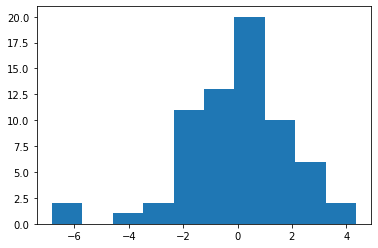

In [11]:
# Run vyskopis analysis. Output is height for each waypoints -- add that to the osm analysis output.
vyskopis_data = vyskopis.DataPoints("waypoints.csv",xyz_file[:-3]+"csv",4)
waypoints_height = vyskopis_data.run()

for i,height in enumerate(waypoints_height):
    waypoints_information[i].height = height

    if i < len(waypoints_height)-1:
        point = waypoints_information[i]
        next_point = waypoints_information[i+1]
        next_point_height = waypoints_height[i+1]
        slope = degrees(atan2(height-next_point_height, np.sqrt((point.x - next_point.x)**2+(point.y - next_point.y)**2)))
        waypoints_information[i].slope = slope
    else:
        waypoints_information[i].slope = waypoints_information[i-1].slope
    
plt.hist([point.slope for point in waypoints_information])
plt.show()

In [18]:
def get_color(point):
    if point.inside_barrier:
        return 'red'
    elif point.roads:
        return '#ffc800'
    else:
        return 'green'

def get_edgecolor(point):
    if point.is_crossing_road:
        return '#000000'
    else:
        #return "#ababab"
        return get_color(point)

def get_marker(point):
    if point.slope > SAFE_SLOPE:
        return 'v'
    if point.slope < -SAFE_SLOPE:
        return '^'
    else:
        return 'o'

def get_label(point):
    css = """
        table
        {
        border-collapse: collapse;
        }
        th
        {
        color: #ffffff;
        background-color: #000000;
        }
        td
        {
        color: #000000;
        background-color: #cccccc;
        }
        table, th, td
        {
        font-family:Arial, Helvetica, sans-serif;
        border: 1px solid black;
        text-align: right;
        }
        """

    tags = point.repr_dict() 
    tags['slope'] = [None,round(point.slope,2)] 

    df = pd.DataFrame.from_dict(tags, orient='index')
    df.fillna('-', inplace=True)
    label = df
    #label = df.T
    label = str(label.to_html(header = False))
    return [label],css

def plot_barrier_areas(barrier_areas, ax):
    for area in barrier_areas:
        x,y = area.line.exterior.xy
        ax.plot(x, y, c='#FF0000', linewidth=5, zorder = 3)
        ax.fill(x,y,c='#FF0000', alpha=0.2, zorder = 2, fill=False, hatch = '/')

def plot_roads(roads, ax):
    for road in roads:
        if road.is_area:
            x,y = road.line.exterior.xy
        else:
            x,y = road.line.xy

        ax.plot(x, y, c='#707070', linewidth=8, zorder = 12)
        ax.plot(x, y, c='#000000', linewidth=10, zorder = 10)
        ax.plot(x, y, c='#ffffff', linewidth=2, linestyle = '--', zorder = 14)

def plot_footways(footways, ax):
    for footway in footways:
        if footway.is_area:
            x,y = footway.line.exterior.xy
        else:
            x,y = footway.line.xy

        ax.plot(x, y, c='#968A71', linewidth=4, zorder = 6)
        ax.plot(x, y, c='#000000', linewidth=6, zorder = 4)
        #ax.plot(x, y, c='#ffffff', linewidth=1, linestyle = '--', zorder = 4)

def get_margin(min_long,max_long,min_lat,max_lat):
    y_margin = (max_lat-min_lat) * 0.1
    x_margin = (max_long-min_long) * 0.1

    if y_margin < x_margin:
        y_margin = x_margin
    else:
        x_margin = y_margin
    
    return x_margin, y_margin

def plot_background_map(ax, image):

    min_utm = utm.from_latlon(min_lat - y_margin, min_long - x_margin)
    max_utm = utm.from_latlon(max_lat + y_margin, max_long + x_margin)
    ax.imshow(image, extent = [min_utm[0],\
                                max_utm[0],\
                                min_utm[1],\
                                max_utm[1]], alpha = 0.7, zorder = 0)

    ax.set_ylim([min_utm[1], max_utm[1]])
    ax.set_xlim([min_utm[0], max_utm[0]])

In [13]:
x_margin, y_margin = get_margin(min_long,max_long,min_lat,max_lat)
background_map = get_background_image(min_long, max_long, min_lat, max_lat, x_margin, y_margin)

https://maps.geoapify.com/v1/staticmap?style=osm-carto&width=4000&height=3289&area=rect:14.417387677444738,50.078624137232104,14.422750919213003,50.07578599543962&apiKey=8f3be3c0c8484eceb15b0f50218c8c02


In [19]:
# Visualize
fig, ax = plt.subplots(figsize=(12,12), dpi=200)
N = 100

plot_background_map(ax, background_map)
plot_barrier_areas(barrier_areas,ax)
plot_roads(roads,ax)
plot_footways(footways,ax)

for point in waypoints_information:
    color = get_color(point)
    edgecolor = get_edgecolor(point)
    alpha = 1
    size = 40
    marker = get_marker(point)
    label, css = get_label(point)

    scatter = ax.scatter(point.x, point.y, color=color, edgecolor=edgecolor, linewidth = 3, alpha=alpha, s=size, marker=marker, zorder = 100)
    tooltip = plugins.PointHTMLTooltip(scatter, voffset=10, hoffset=10, css=css, labels = label)
    plugins.connect(fig, tooltip)
        
ax.set_aspect('equal', adjustable='box')
ax.set_xlabel('Easting (m)')
ax.set_ylabel('Northing (m)')
mpld3.display()


In [15]:
""" # Visualize
fig, ax = plt.subplots(figsize=(6, 4.5), dpi=120)
N = 100

# Points inside barrier
mask_1 = np.array([True if point.inside_barrier != [] and not point.slope > SAFE_SLOPE else False for point in waypoints_information])
points_1 = waypoints_information[mask_1]
x_1 = np.array([point.x for point in points_1])
y_1 = np.array([point.y for point in points_1])
z_1 = np.array([point.height for point in points_1])
scatter_1 = ax.scatter(x_1,y_1,color='red',alpha=1.0, marker='o')
tooltip_1 = mpld3.plugins.PointLabelTooltip(scatter_1, labels = z_1)

mask_1_slope = np.array([True if point.inside_barrier != [] and point.slope > SAFE_SLOPE else False for point in waypoints_information])
points_1_slope = waypoints_information[mask_1_slope]
x_1_slope = np.array([point.x for point in points_1_slope])
y_1_slope = np.array([point.y for point in points_1_slope])
z_1_slope = np.array([point.height for point in points_1_slope])
scatter_1_slope = ax.scatter(x_1_slope,y_1_slope,color='red',alpha=1.0, marker='^')
tooltip_1_slope = mpld3.plugins.PointLabelTooltip(scatter_1_slope, labels = z_1_slope)

# Points on a road
mask_2 = np.array([True if point.roads and not point.is_crossing_road and not point.slope > SAFE_SLOPE else False for point in waypoints_information])
mask_2 = mask_2 & ~mask_1 & ~mask_1_slope
points_2 = waypoints_information[mask_2]
x_2 = np.array([point.x for point in points_2])
y_2 = np.array([point.y for point in points_2])
z_2 = np.array([np.array(point.roads)[0,1] for point in points_2])
scatter_2 = ax.scatter(x_2,y_2,color='#ffc800',alpha=1.0, marker='o')
tooltip_2 = mpld3.plugins.PointLabelTooltip(scatter_2, labels = z_2)

mask_2_slope = np.array([True if point.roads and not point.is_crossing_road and point.slope > SAFE_SLOPE else False for point in waypoints_information])
mask_2_slope = mask_2_slope & ~mask_1 & ~mask_1_slope
points_2_slope = waypoints_information[mask_2_slope]
x_2_slope = np.array([point.x for point in points_2_slope])
y_2_slope = np.array([point.y for point in points_2_slope])
z_2_slope = np.array([np.array(point.roads)[0,1] for point in points_2_slope])
scatter_2_slope = ax.scatter(x_2_slope,y_2_slope,color='#ffc800',alpha=1.0, marker='^')
tooltip_2_slope = mpld3.plugins.PointLabelTooltip(scatter_2, labels = z_2_slope)


# Points on a road and crossing
mask_3 = np.array([True if point.is_crossing_road and not point.slope > SAFE_SLOPE else False for point in waypoints_information])
mask_3 = mask_3 & ~mask_2 & ~mask_2_slope & ~mask_1 & ~mask_1_slope
points_3 = waypoints_information[mask_3]
x_3 = np.array([point.x for point in points_3])
y_3 = np.array([point.y for point in points_3])
z_3 = np.array([np.array(point.roads)[0,1] for point in points_3])
scatter_3 = ax.scatter(x_3,y_3,color='#ffc800',alpha=1.0, marker='o', edgecolor='#000000')
tooltip_3 = mpld3.plugins.PointLabelTooltip(scatter_3, labels = z_3)

mask_3_slope = np.array([True if point.is_crossing_road and point.slope > SAFE_SLOPE else False for point in waypoints_information])
mask_3_slope = mask_3_slope & ~mask_2 & ~mask_2_slope & ~mask_1 & ~mask_1_slope
points_3_slope = waypoints_information[mask_3_slope]
x_3_slope = np.array([point.x for point in points_3_slope])
y_3_slope = np.array([point.y for point in points_3_slope])
z_3_slope = np.array([np.array(point.roads)[0,1] for point in points_3_slope])
scatter_3_slope = ax.scatter(x_3_slope,y_3_slope,color='#ffc800',alpha=1.0, marker='^', edgecolor='#000000')
tooltip_3_slope = mpld3.plugins.PointLabelTooltip(scatter_3_slope, labels = z_3_slope)


# Accessible points
mask_4 = np.array([True if point.is_crossing_road else False for point in waypoints_information])
mask_4 = mask_4 & ~mask_2 & ~mask_1
points_4 = waypoints_information[mask_4]
x_4 = np.array([point.x for point in points_4])
y_4 = np.array([point.y for point in points_4])
z_4 = np.array([np.array(point.roads)[0,1] for point in points_4])
scatter_4 = ax.scatter(x_3,y_3,color='#ffc800',alpha=1.0, marker='o', edgecolor='#000000')
tooltip_4 = mpld3.plugins.PointLabelTooltip(scatter_4, labels = z_4)



mpld3.plugins.connect(fig, tooltip_1)
mpld3.plugins.connect(fig, tooltip_2)
mpld3.plugins.connect(fig, tooltip_3)
mpld3.enable_notebook()
mpld3.display()
 """

" # Visualize\nfig, ax = plt.subplots(figsize=(6, 4.5), dpi=120)\nN = 100\n\n# Points inside barrier\nmask_1 = np.array([True if point.inside_barrier != [] and not point.slope > SAFE_SLOPE else False for point in waypoints_information])\npoints_1 = waypoints_information[mask_1]\nx_1 = np.array([point.x for point in points_1])\ny_1 = np.array([point.y for point in points_1])\nz_1 = np.array([point.height for point in points_1])\nscatter_1 = ax.scatter(x_1,y_1,color='red',alpha=1.0, marker='o')\ntooltip_1 = mpld3.plugins.PointLabelTooltip(scatter_1, labels = z_1)\n\nmask_1_slope = np.array([True if point.inside_barrier != [] and point.slope > SAFE_SLOPE else False for point in waypoints_information])\npoints_1_slope = waypoints_information[mask_1_slope]\nx_1_slope = np.array([point.x for point in points_1_slope])\ny_1_slope = np.array([point.y for point in points_1_slope])\nz_1_slope = np.array([point.height for point in points_1_slope])\nscatter_1_slope = ax.scatter(x_1_slope,y_1_slope,